---
format: 
  html:
    toc: true
    code-fold: true
execute:
  echo: true
---

# Amenity Analysis

This analysis looks at the number of amenities located within the flood hazard area in the city of Philadelphia. Amenity data is downloaded from Open Street Maps, and I also determine the planning district that each amenity is located in. I present the results using interactive maps created using the geopandas explore() function and charts created using the altair package.

# Import Packages

I import the packages I will use for this analysis. I used osmnx to download data from Open Street Maps. Pandas and geopandas are used to manipulate and transform my data. Altair and matplotlib are used to create visualizations.

In [46]:
import pandas as pd
import osmnx as ox
from matplotlib import pyplot as plt
import geopandas as gpd
import altair as alt
import pygris

In [47]:
import warnings
warnings.filterwarnings('ignore')

In [48]:
pd.set_option('display.max_columns', None)

# Download Amenitiy Data from OSM

I download amenity data from Open Street Maps for all of Philadelphia. I try to focus on key public amenities that would be problematic to have in a flood hazard area and could be damaged durring a flood. The OSM amenity data is projected into an apporporiate cordinate system. I then count the number of each amenity type located in Philadelphia.

In [49]:
amenities = ox.features_from_place("Philadelphia, PA", tags={"amenity": ["bar","place_of_worship","restaurant",\
                                                                         "school","fast_food","cafe","bank","fuel" \
                                                                        "bar","pub","library","post_office","fire_station",\
                                                                        "community_centre","kindergarten","theatre" \
                                                                        "hospital","police","cinema"]})

In [50]:
amenities = amenities.to_crs(6565) 

The chart below was created using matplotlib and shows the total number of each type of amenity in Philadelphia based on OSM data.

Text(0.5, 1.0, 'Number of Amenities in Philadelphia based on OSM data')

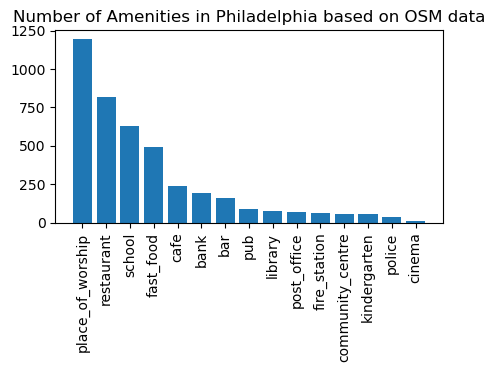

In [51]:
fig, ax = plt.subplots(figsize=(5, 2.5))

groups = amenities.groupby('amenity')[['amenity']].count().rename({'amenity':'count'},axis=1)
groups = groups.sort_values('count',ascending=False)

plt.bar(height=groups['count'],x=groups.index)

plt.xticks(rotation = 90)
plt.title('Number of Amenities in Philadelphia based on OSM data')

# Get Data on Flood Plains

Next, I get the flood hazard boundary data from the city's open data portal. The 100 year and 500 year flood plain are included as seperate layers. I perform some cleaning operations to both layers and then concatenate them together using the concat function in pandas.

In [52]:
flood_plain_100_year = gpd.read_file('https://opendata.arcgis.com/datasets/1d6d353ab50b4884b586c05ee2a661db_0.geojson').to_crs(6565)
flood_plain_500_year = gpd.read_file('https://opendata.arcgis.com/datasets/1e6f6315225544c88549478d25cc5181_0.geojson').to_crs(6565)

In [53]:
flood_plain_100_year.loc[flood_plain_100_year['FLOODWAY'] == 'FLOODWAY', ['ZONE']] = 'FLOODWAY'
flood_plain_100_year = flood_plain_100_year[['geometry','ZONE']].fillna('100 YEAR')

In [54]:
flood_plain_500_year['ZONE'] = '500 YEAR'
flood_plain_500_year = flood_plain_500_year[['geometry','ZONE']]

In [55]:
flood_plain = pd.concat([flood_plain_100_year,flood_plain_500_year])

The interactive map below shows where the flood hazard areas are located in Philadelphia.

In [56]:
flood_plain.explore(column='ZONE',tiles='CartoDB positron',cmap='winter',style_kwds ={'stroke':False})

# Identify Amenities in the Flood Zone

Next, I identify the public amenities located in the flood hazard zone using a spatial join.

In [57]:
amenities['geometry'] = amenities.geometry.centroid
amenities_join = amenities.sjoin(flood_plain,how='left',predicate='within').reset_index()

In [58]:
amenities_join = amenities_join[['amenity','geometry','name','ZONE']].fillna('Not in Floodplain')
amenities_join.replace({"FLOODWAY":"100 YEAR"},inplace=True)

## Data Visualization

The chart below shows the percentage of each amenity located in the 100 year flood zone, the 500 year flood zone, and amenities located outside of the flood plain. Pubs, fire stations, and fast food restaurants have the highest percentage of points located in the flood hazard zone. The high percentage of fire stations located in the flood zone is concerning, due to the imortant role this feature plays in emergancy response.

In [59]:
domain = ['100 YEAR', '500 YEAR', 'Not in Floodplain']
range1 = ['blue','lightblue','lightgrey']

alt.Chart(amenities_join).mark_bar().encode(
    alt.X('amenity').title('Amenity Type'),
    alt.Y('count(amenity)').title('Percent of Total').stack("normalize"),
    alt.Color('ZONE').scale(domain=domain, range=range1),
    tooltip=['amenity','count(amenity)','ZONE']
).properties(
    width=400,
    height=300,
    title='Percent of Citywide Amenities Located in Areas Vulnerable to Flooding'
)

alt.Chart(...)

Next, I create a copy of the amenities dataframe which just includes amenities located in the flood hazard zone.

In [60]:
filt = amenities_join['ZONE'] != 'Not in Floodplain'
amenities_flood = amenities_join.loc[filt]

The interactive map below shows the location of amenities which are located in the flood hazard zone. The amenities are colored according to the amenity type. Hover over a point to view more information about the amenity.

In [61]:
amenities_flood.explore(column='amenity',tiles='CartoDB positron')

The chart below shows the number of amenities by amenity type located in the flood hazard area. The color allows for distinguishing between amenities in the 100 year and 500 year flood hazard zones. There are a large number of restaurants and fast food establishments located in flood hazard areas.

In [62]:
domain1 = ['100 YEAR','500 YEAR']
range2 = ['blue','lightblue']

alt.Chart(amenities_flood).mark_bar().encode(
    alt.X('amenity').title('Amenity Type'),
    alt.Y('count(amenity)').title('Total'),
    alt.Color('ZONE').scale(domain=domain1, range=range2),
    tooltip=['amenity','count(amenity)','ZONE']
).properties(
    width=400,
    height=300,
    title='Number of Amenities Located in Areas Vulnerable to Flooding'
)

alt.Chart(...)

# Analysis By Planning District

Next we analyze the number of amenities located in the flood zone by planning district. The planning district dataset is imported using an API link obtained through the Philadelphia Open Data Portal. After importing the planning districts, a spatial join is carried out to join the flood vulnerable amenities to the planning district the amenity is located in.

In [63]:
planning_districts = gpd.read_file('https://opendata.arcgis.com/datasets/0960ea0f38f44146bb562f2b212075aa_0.geojson').to_crs(6565)

In [64]:
amenities_flood = amenities_flood.sjoin(planning_districts[['DIST_NAME','geometry']],how='inner')

The charts below visualize the results of the analysis. The visual is interactive and includes cross filtering between two different charts. Click on a bar in the left chart and the chart on the right will update to just show amenity data for the selected planning district. The chart highlights that the largest number of amenities that are vulnerable to flooding are located within the Lower Southwest planning district.

In [65]:
selection = alt.selection_point(fields=['DIST_NAME'])

lines = alt.Chart().mark_bar().encode(
    alt.X('count(amenity)',title = 'Number of Amenities',axis=alt.Axis(format='0f')),
    alt.Y('amenity').title('Amenity Type'),
    color='ZONE',
    tooltip=["ZONE", "amenity", "count(amenity)"]
).properties(
    width=400,
    height=300,
    title='Amenities located within the flood hazard zone'
).transform_filter(
    selection
)

bars = alt.Chart().mark_bar().encode(
    alt.Y('count(amenity):Q').title('Number of Amenities'),
    alt.X('DIST_NAME:N').title('Planning District'),
    opacity=alt.condition(selection,'1',alt.value(0.2),legend=None)
    ).add_params(selection).properties(
    width=150,
    height=230,
    title={
        "text":"Amenities in Flood Hazard Zone",
        "subtitle": "Click on a bar to fiter right chart",
    }
)

chart = alt.hconcat(bars,lines, data=amenities_flood)
chart

alt.HConcatChart(...)